In [ ]:
"""
This notebook uses the approximate cell locations to automatically segment the cells using SAM
"""

In [1]:
import os
import cv2
import json
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from pathlib import Path
from copy import deepcopy
from utils import place_in_img

from scipy.ndimage import binary_closing
from skimage.exposure import match_histograms

In [2]:
# Code modified from Charlie's masters student

import os
import cv2
import numpy as np
import torch
import torchvision
import matplotlib.pyplot as plt
from PIL import Image

from glob import glob
from tqdm import tqdm

In [3]:
# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )

using device: cuda


In [4]:
np.random.seed(3)

def show_anns(anns, borders=True):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:, :, 3] = 0
    for ann in sorted_anns:
        m = ann['segmentation']
        color_mask = np.concatenate([np.random.random(3), [0.5]])
        img[m] = color_mask 
        if borders:
            import cv2
            contours, _ = cv2.findContours(m.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
            # Try to smooth contours
            contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
            cv2.drawContours(img, contours, -1, (0, 0, 1, 0.4), thickness=1) 

    ax.imshow(img)

def show_mask(mask, ax, random_color=False, borders = True):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask = mask.astype(np.uint8)
    mask_image =  mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    if borders:
        import cv2
        contours, _ = cv2.findContours(mask,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE) 
        # Try to smooth contours
        contours = [cv2.approxPolyDP(contour, epsilon=0.01, closed=True) for contour in contours]
        mask_image = cv2.drawContours(mask_image, contours, -1, (1, 1, 1, 0.5), thickness=2) 
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels==1]
    neg_points = coords[labels==0]
    ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='.', s=marker_size, edgecolor='white', linewidth=1.25)
    ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='.', s=marker_size, edgecolor='white', linewidth=1.25)   

def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0, 0, 0, 0), lw=2))    

def show_masks(image, masks, scores, point_coords=None, box_coords=None, input_labels=None, borders=True):
    for i, (mask, score) in enumerate(zip(masks, scores)):
        plt.figure(figsize=(10, 10))
        plt.imshow(image)
        show_mask(mask, plt.gca(), borders=borders)
        if point_coords is not None:
            assert input_labels is not None
            show_points(point_coords, input_labels, plt.gca(), marker_size=100)
        if box_coords is not None:
            # boxes
            show_box(box_coords, plt.gca())
        
        plt.title(f"Mask {i+1}, Score: {score:.3f}", fontsize=18)
        plt.axis('off')
        plt.show()

In [5]:
from sam2.build_sam import build_sam2
from sam2.sam2_image_predictor import SAM2ImagePredictor


sam2_checkpoint = "sam2_hiera_large.pt"
model_cfg = "sam2_hiera_l.yaml"
sam2_model = build_sam2(model_cfg, sam2_checkpoint, device=device)

predictor = SAM2ImagePredictor(sam2_model)

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

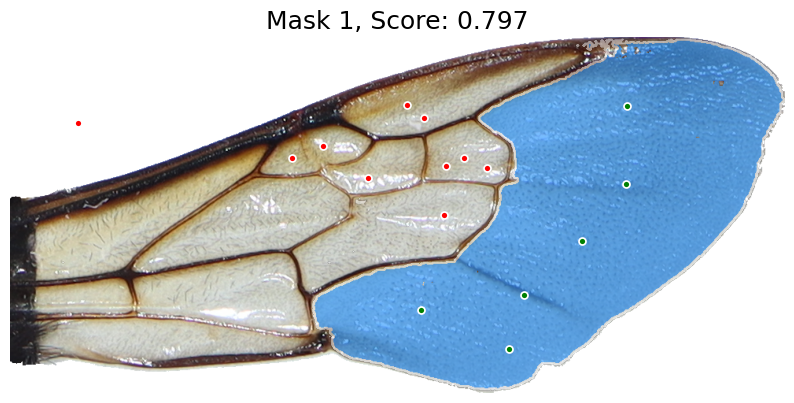

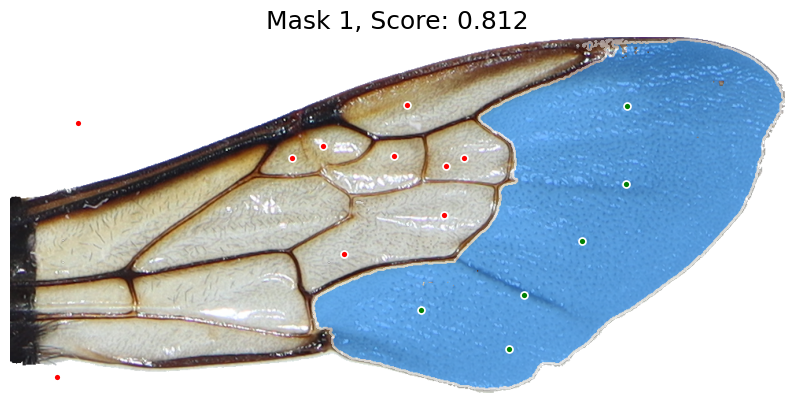

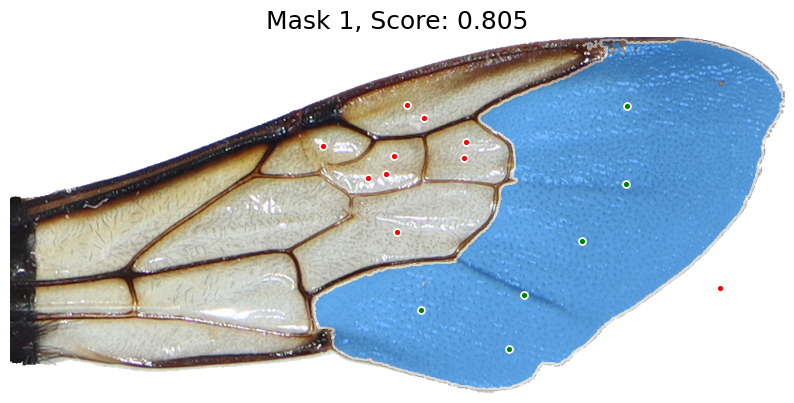

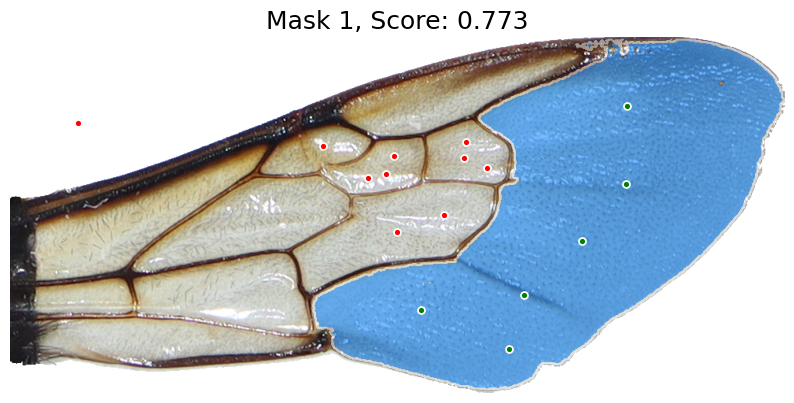

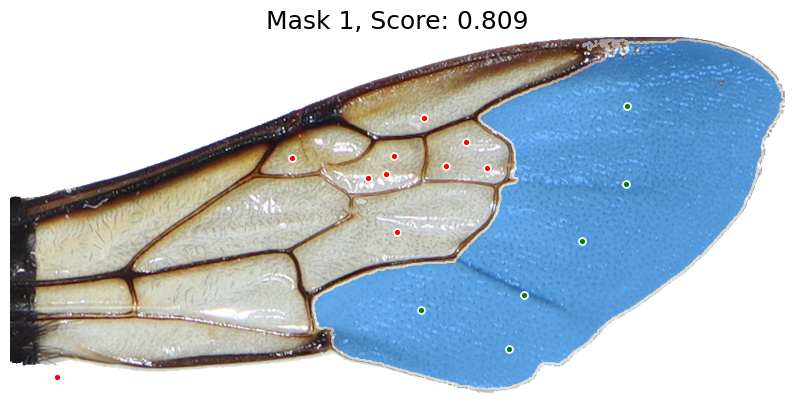

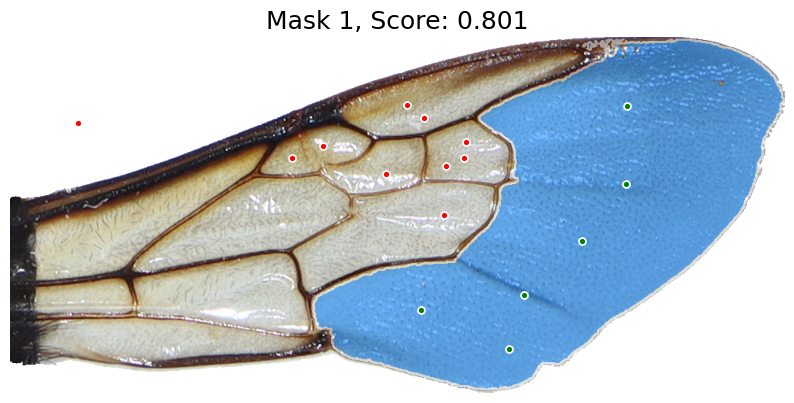

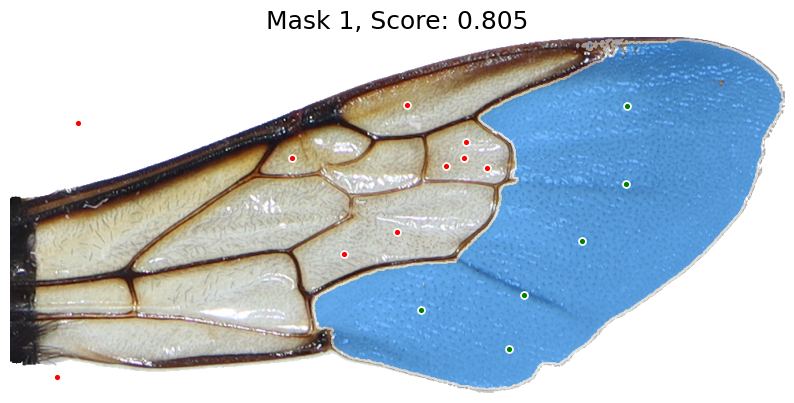

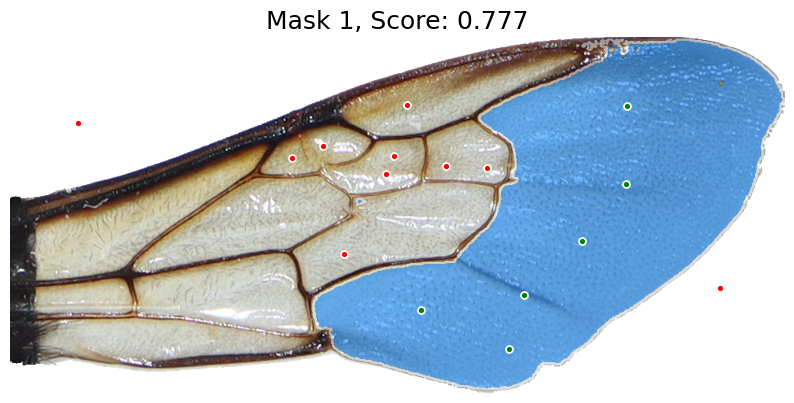

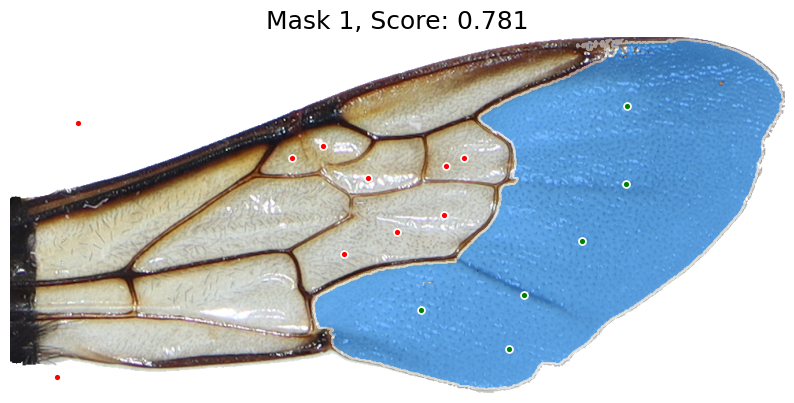

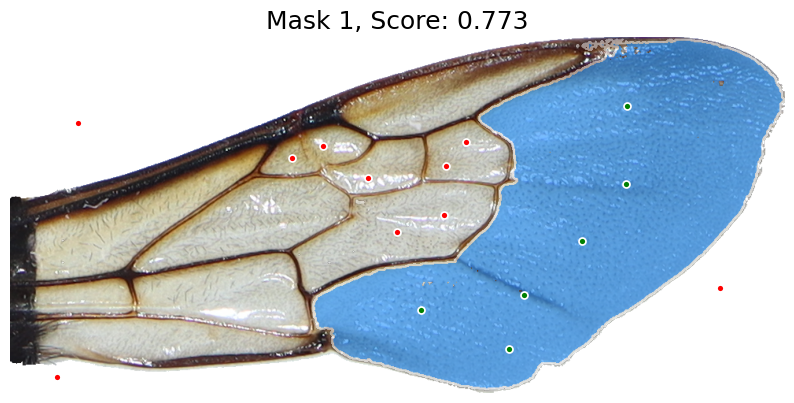

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

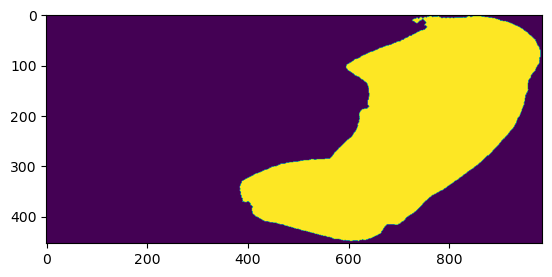

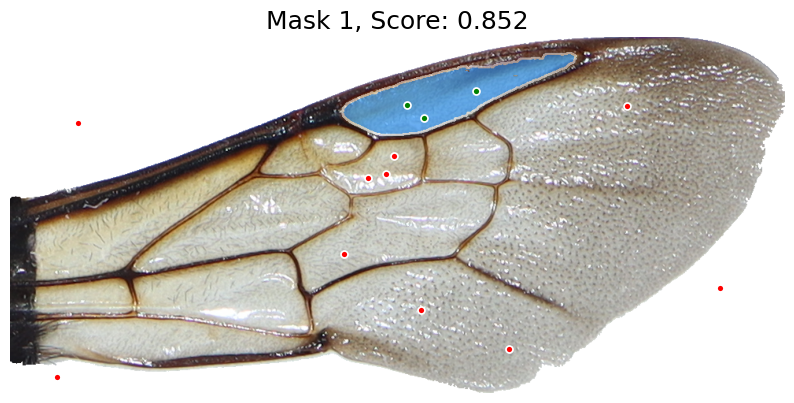

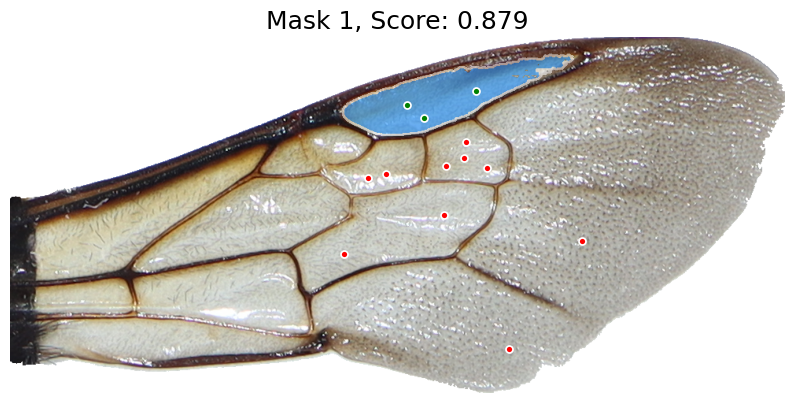

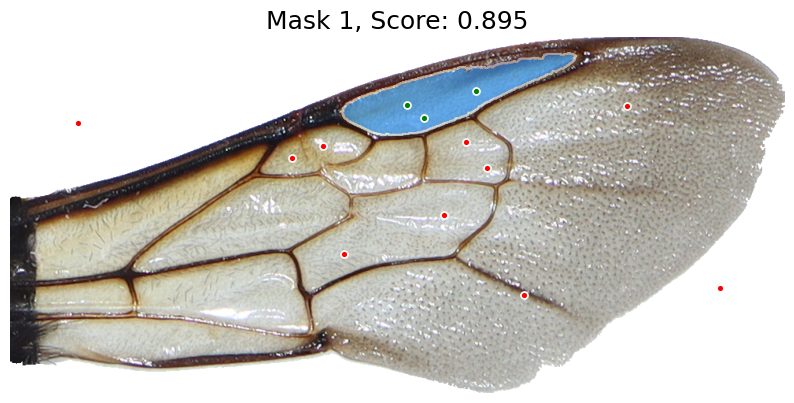

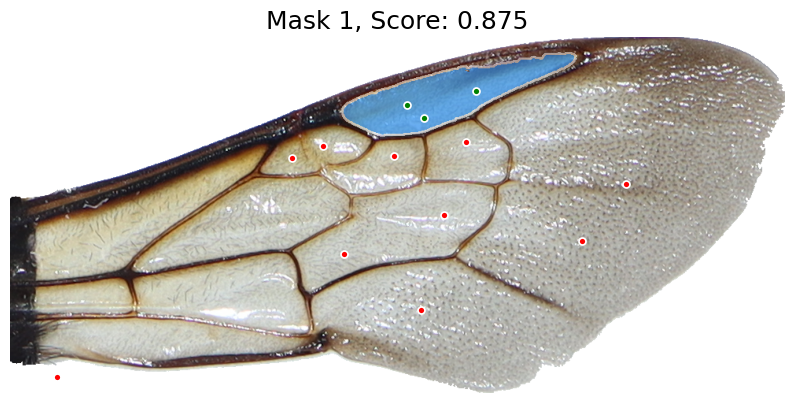

...

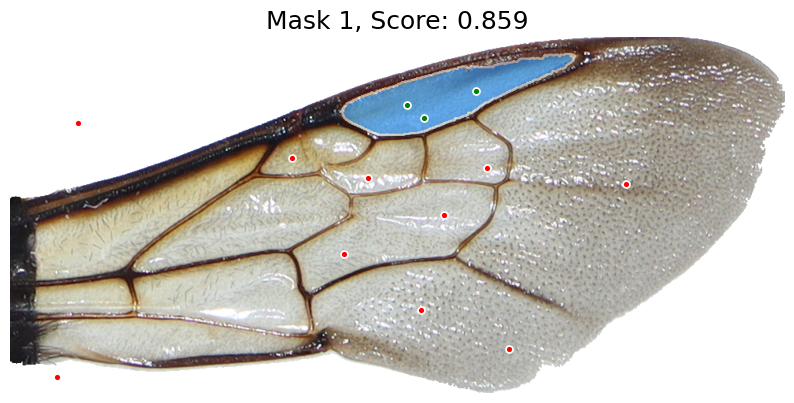

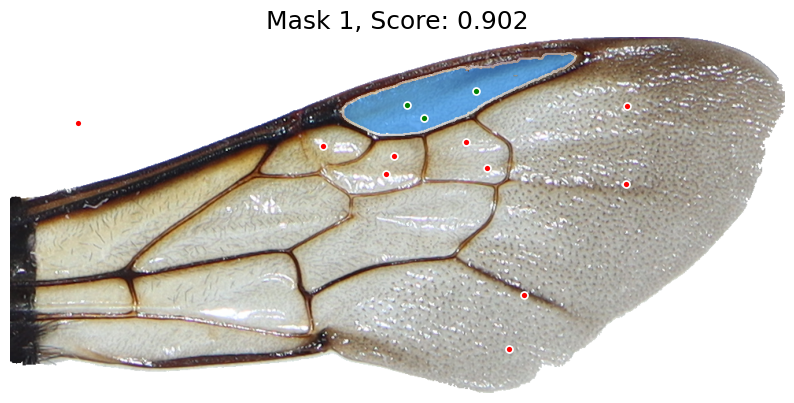

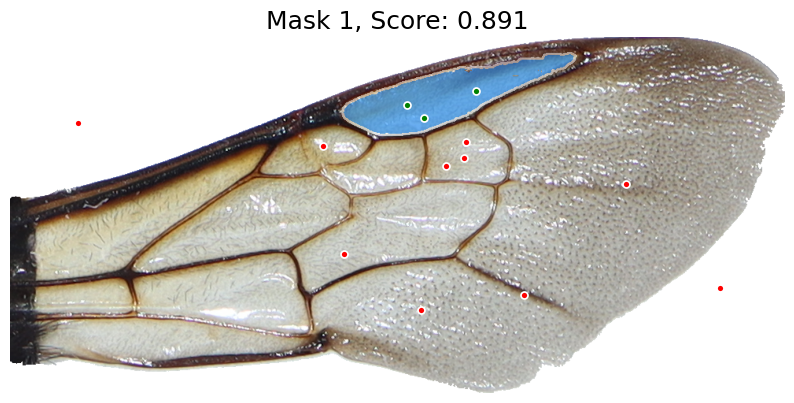

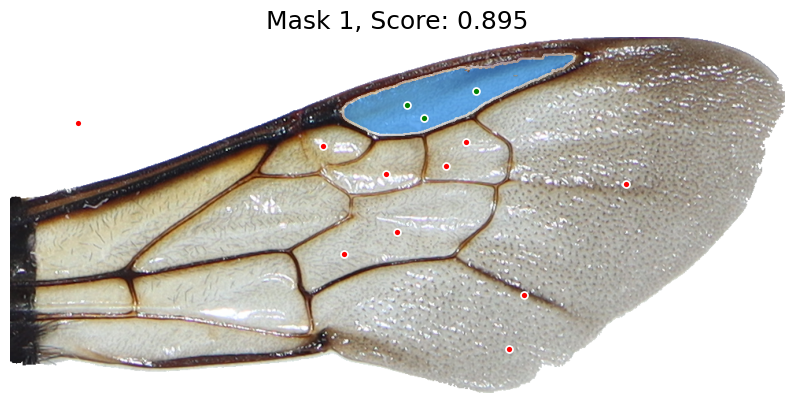

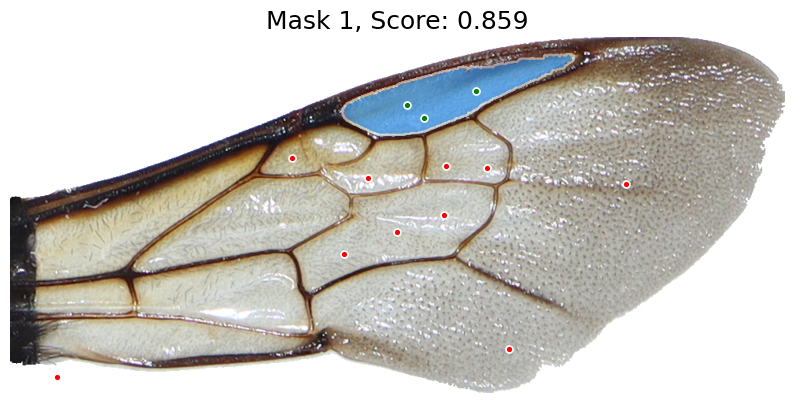

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

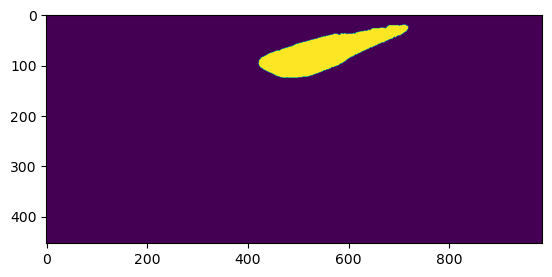

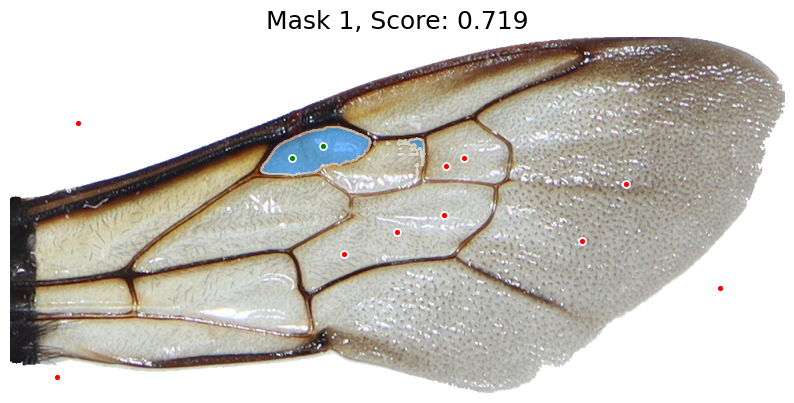

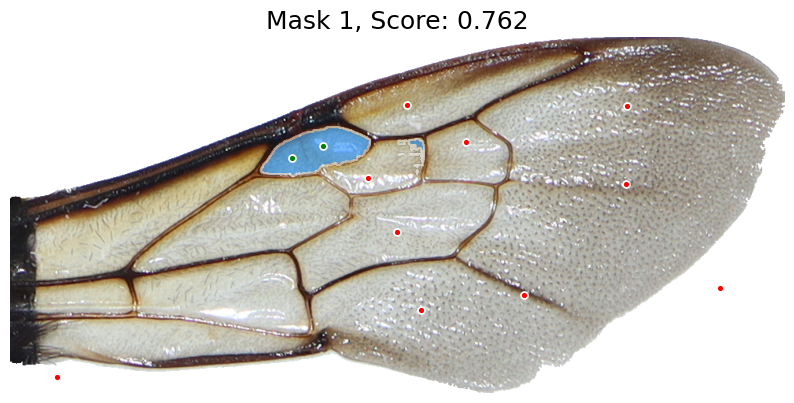

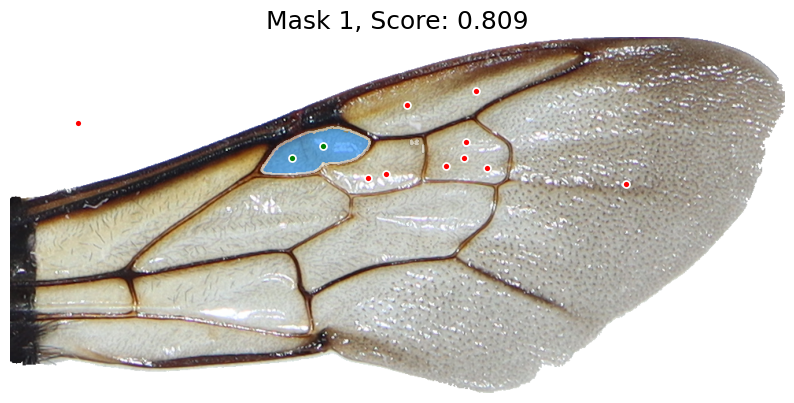

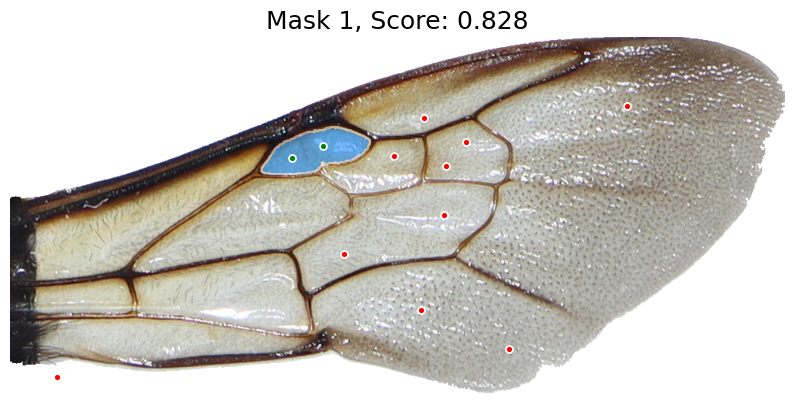

...

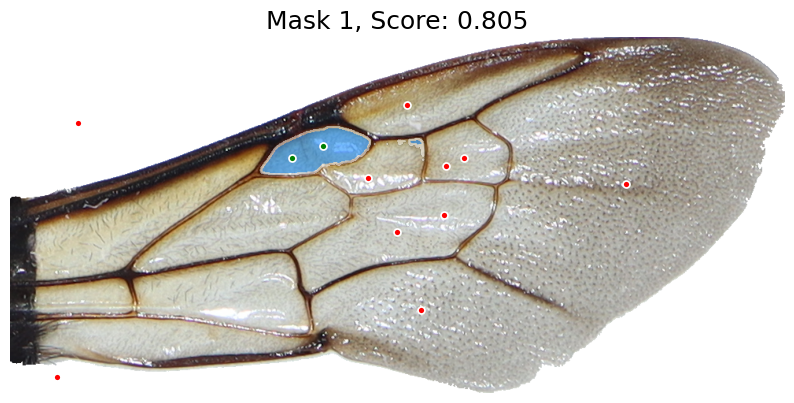

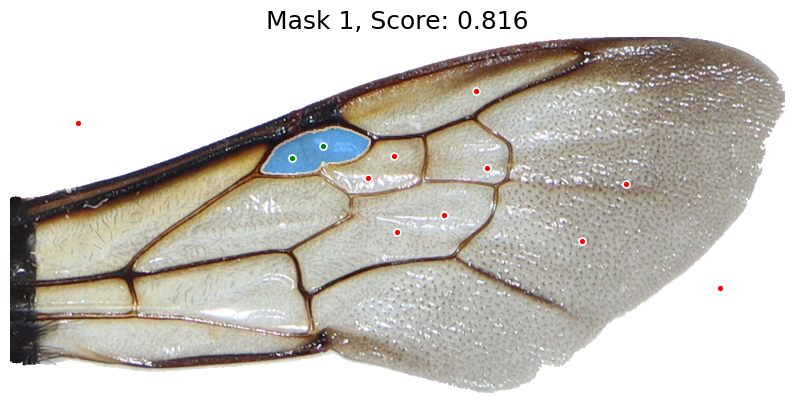

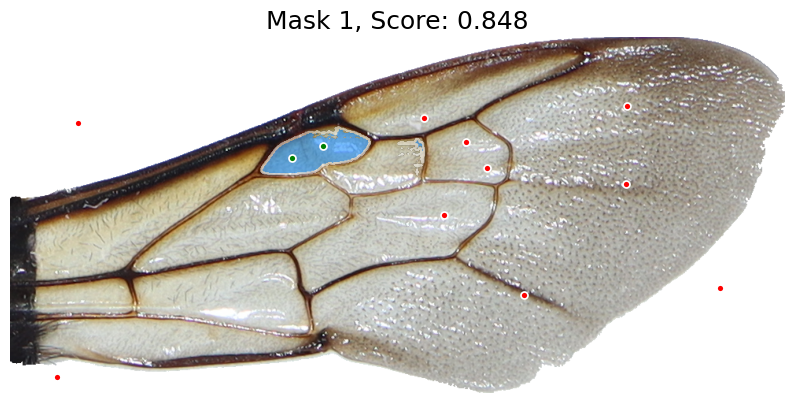

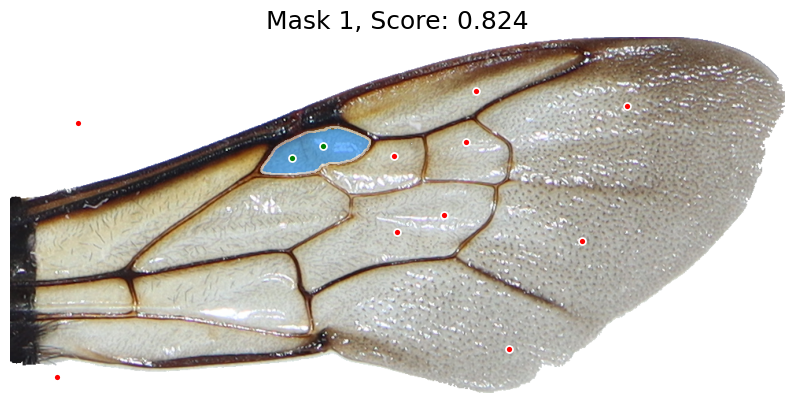

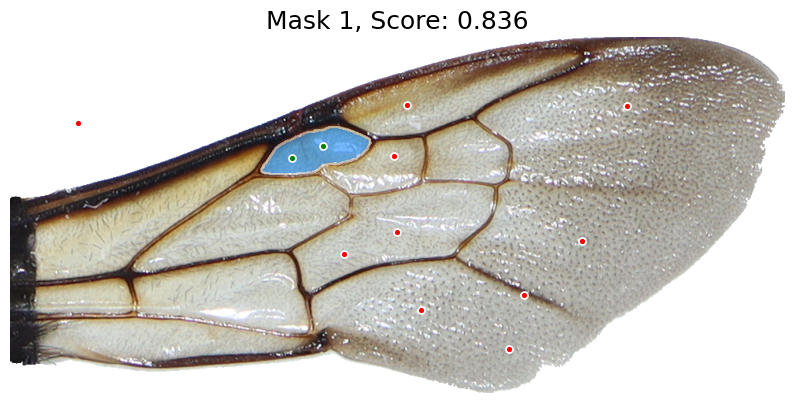

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

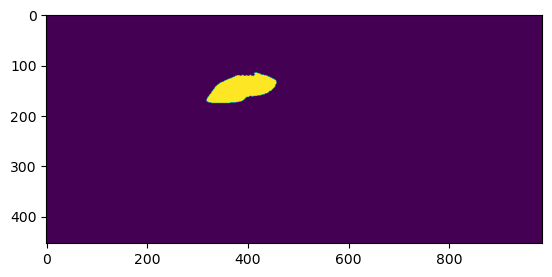

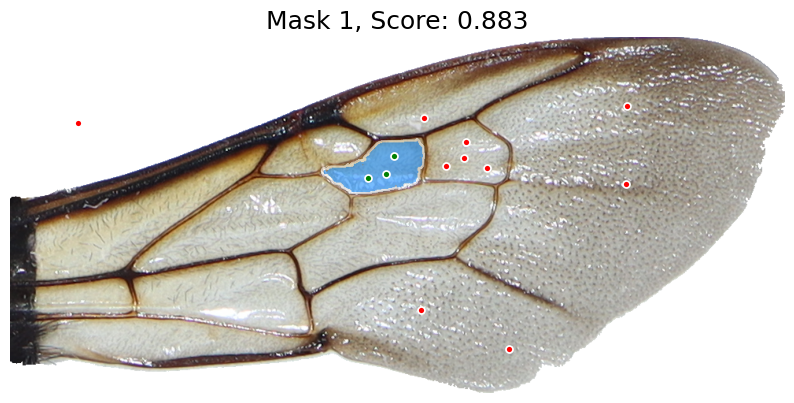

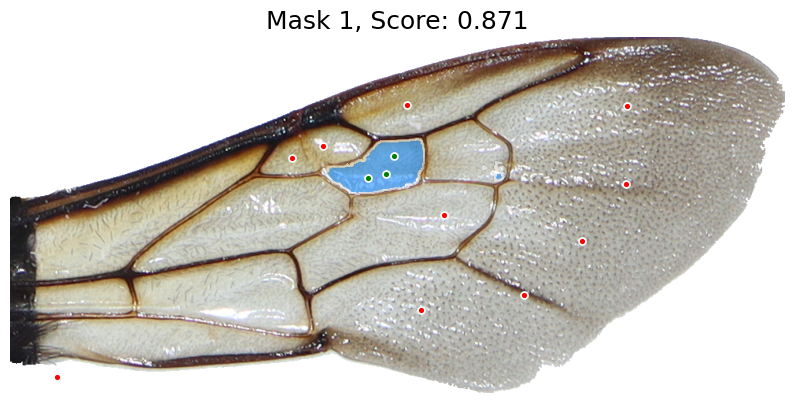

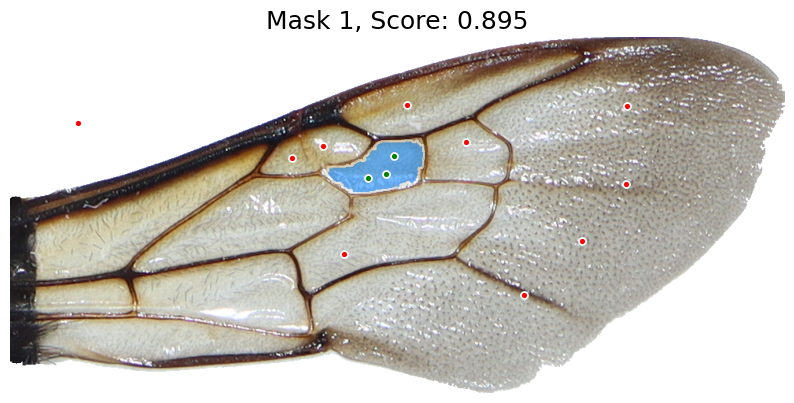

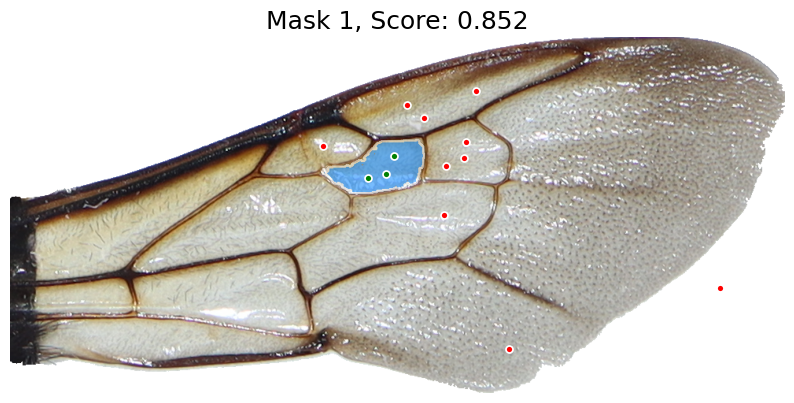

...

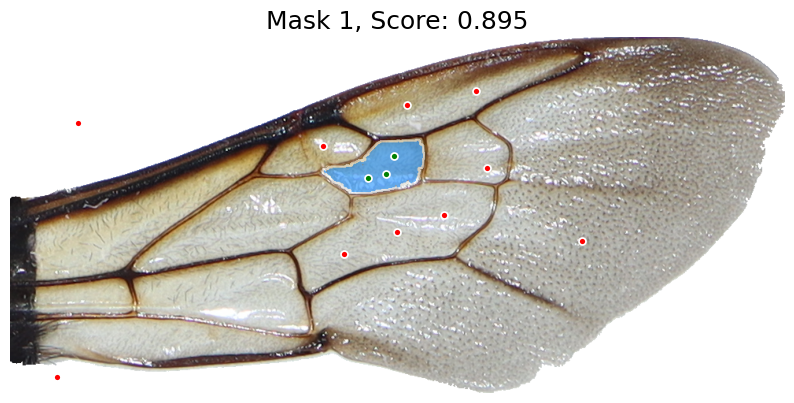

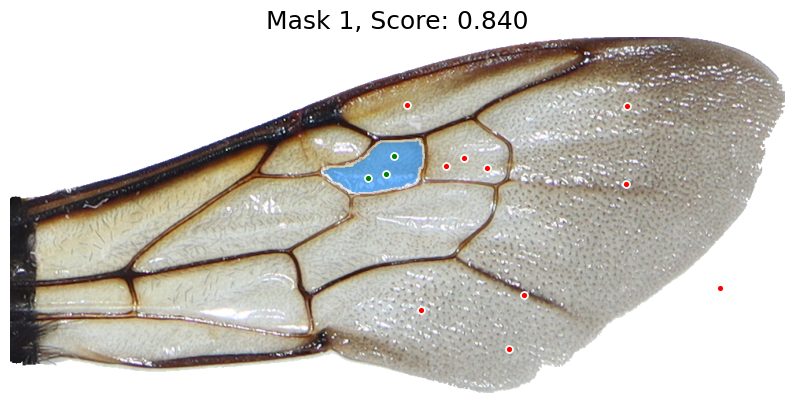

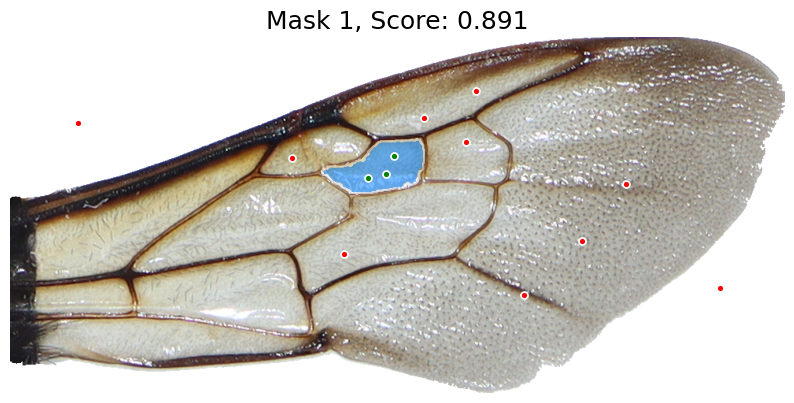

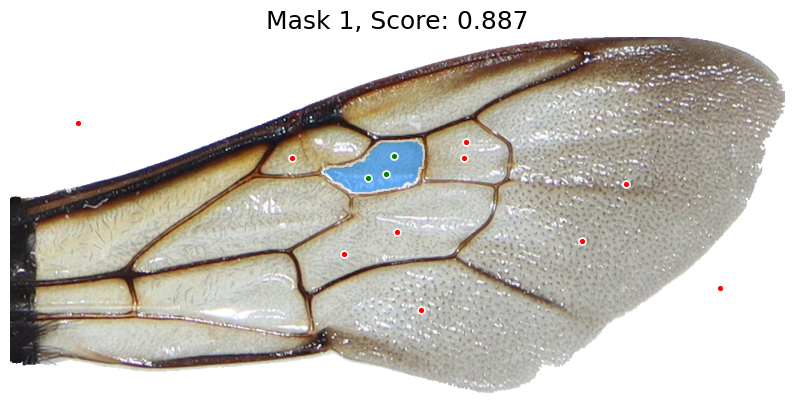

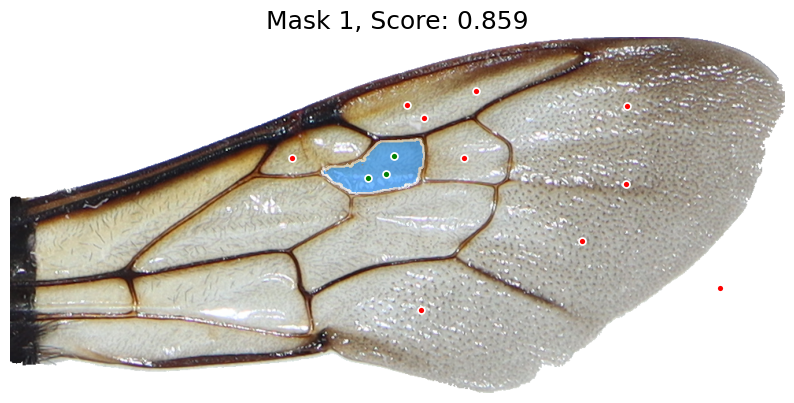

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

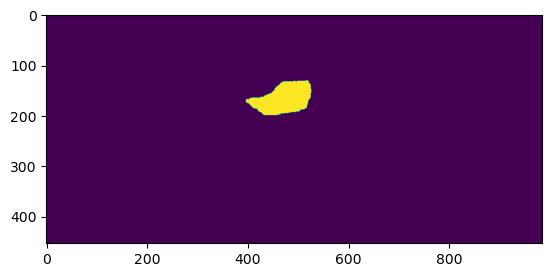

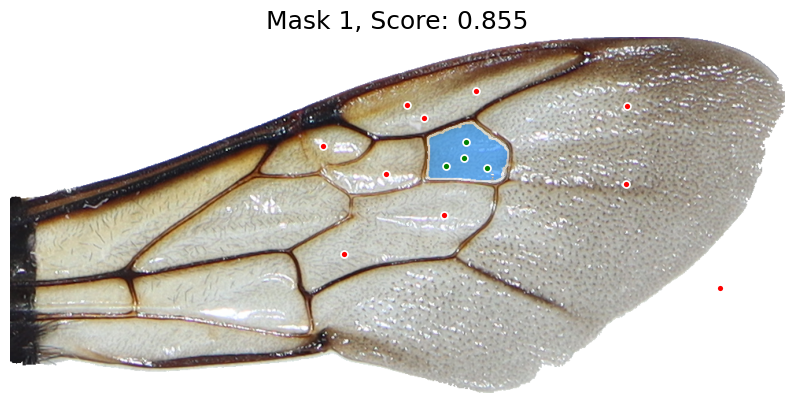

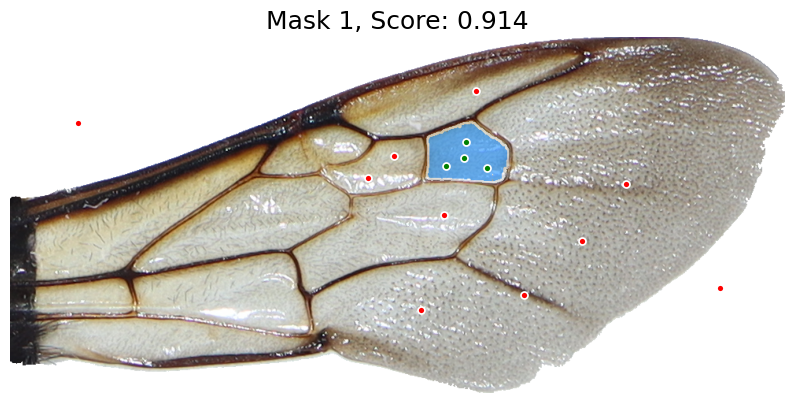

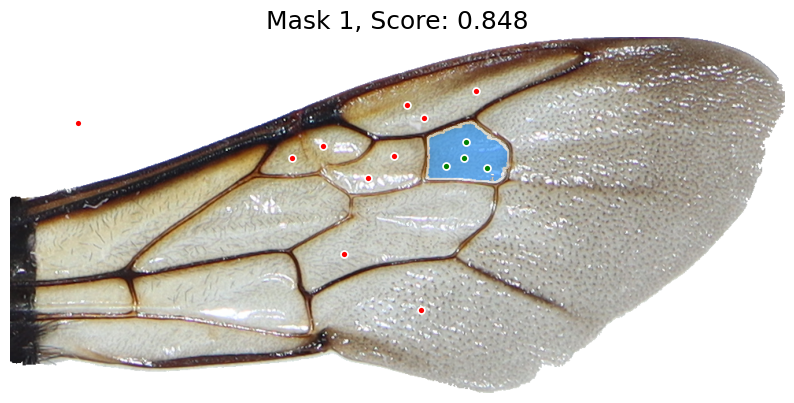

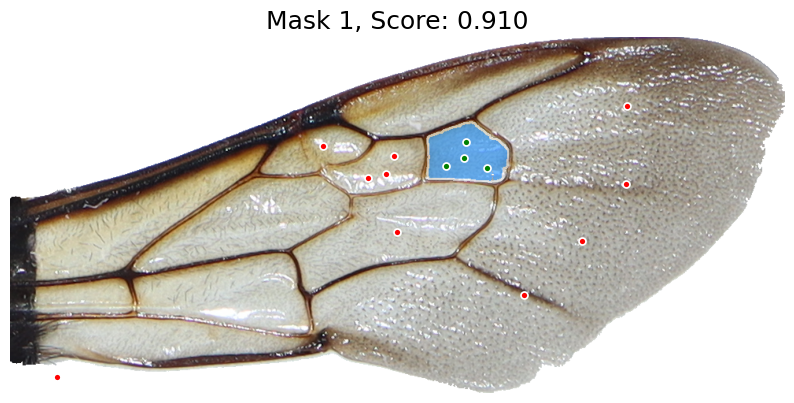

...

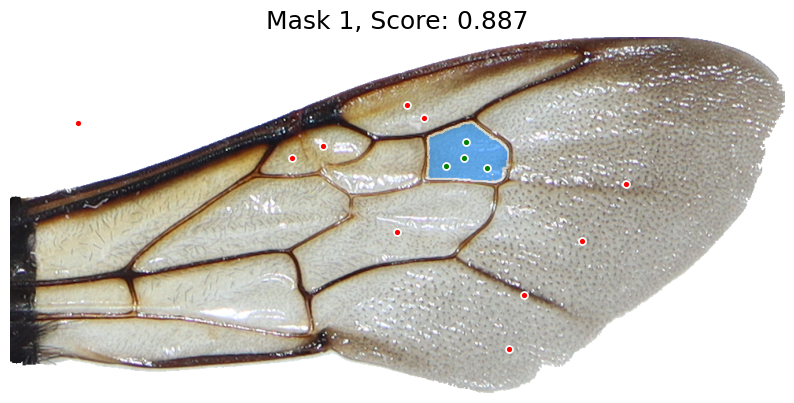

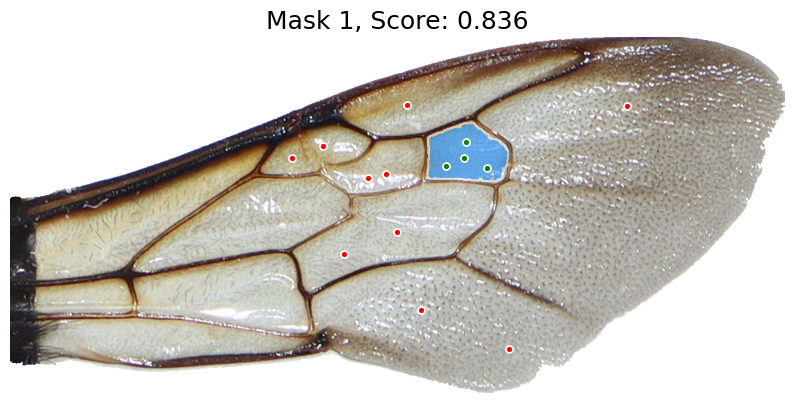

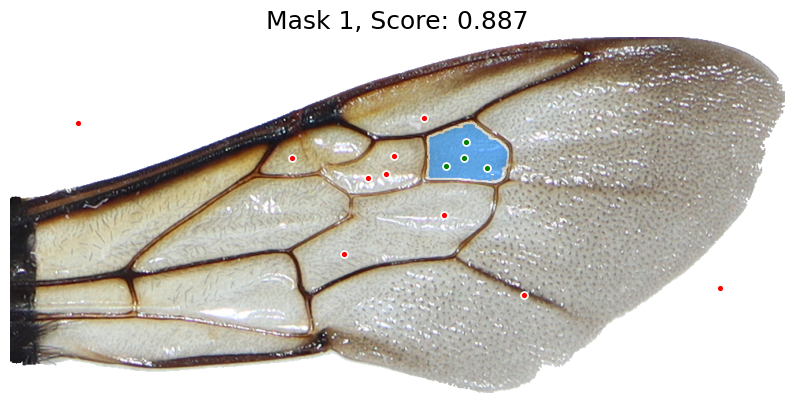

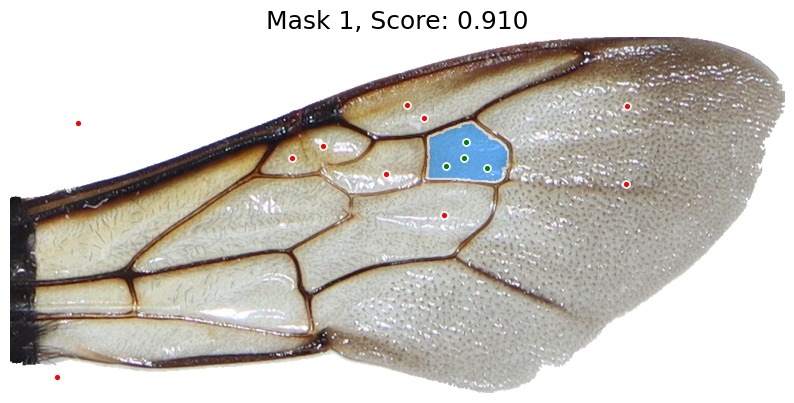

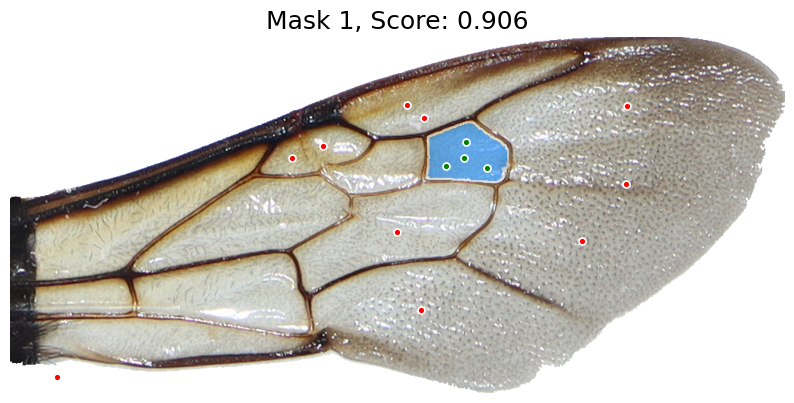

  0%|                                                                                                                                                                                      | 0/1193 [00:00<?, ?it/s]

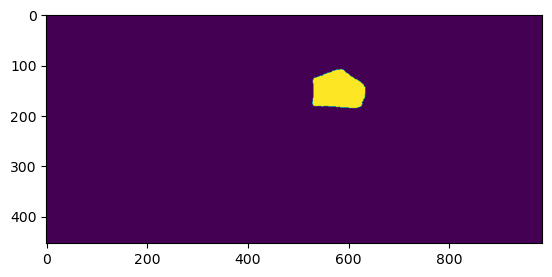

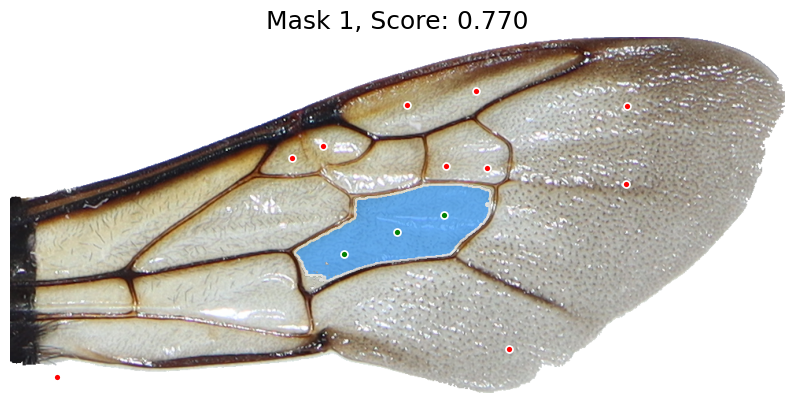

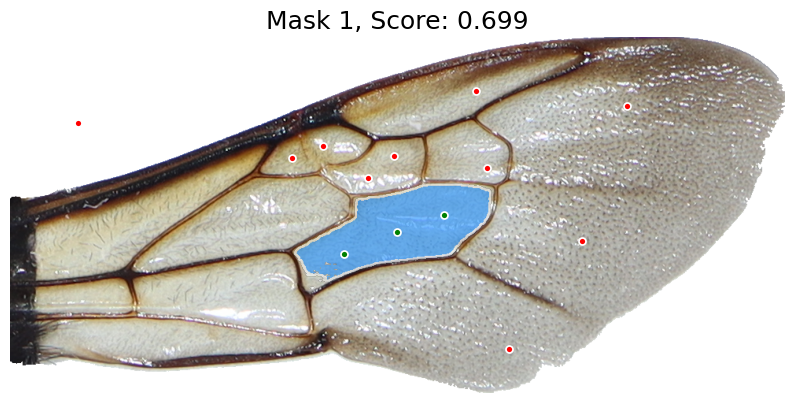

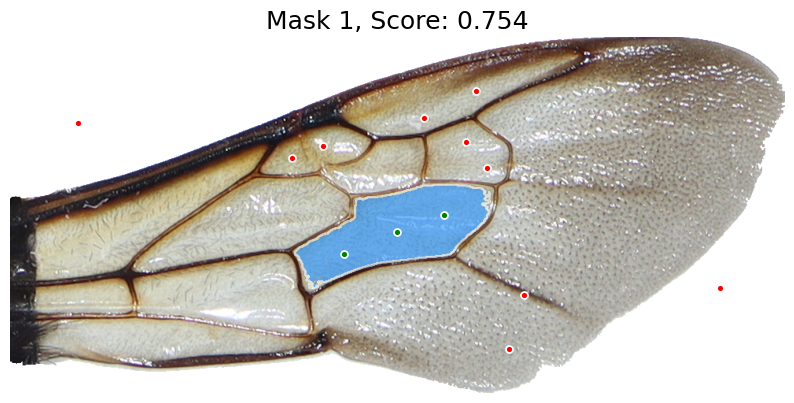

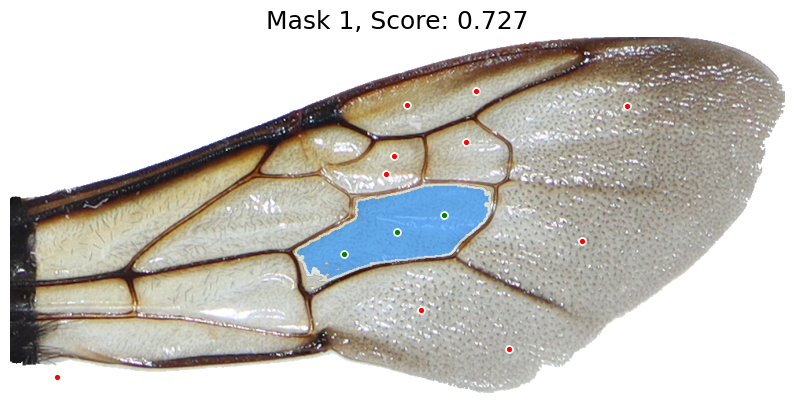

...

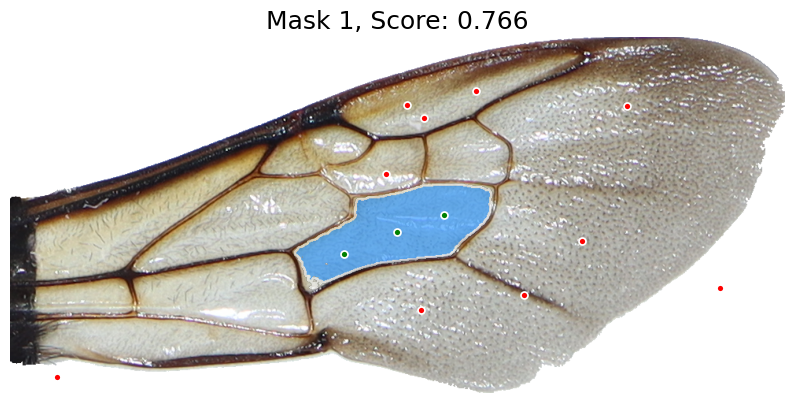

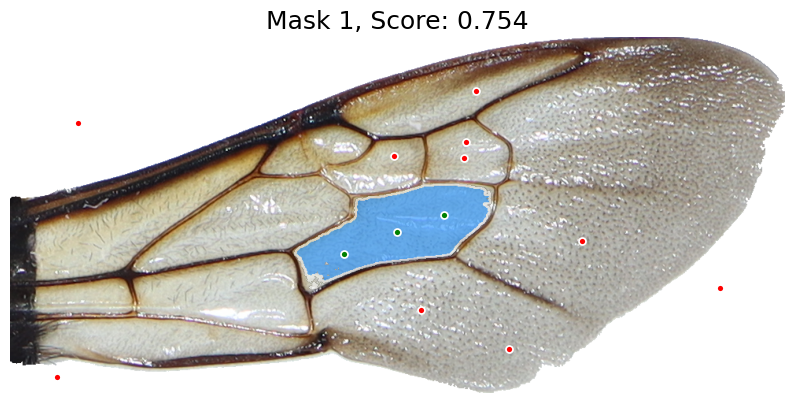

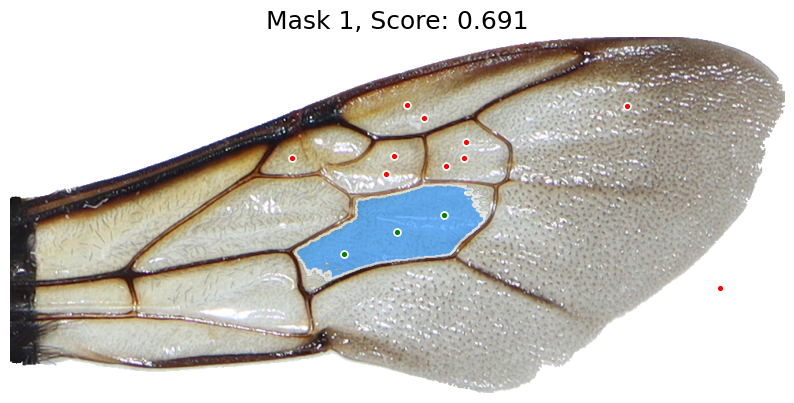

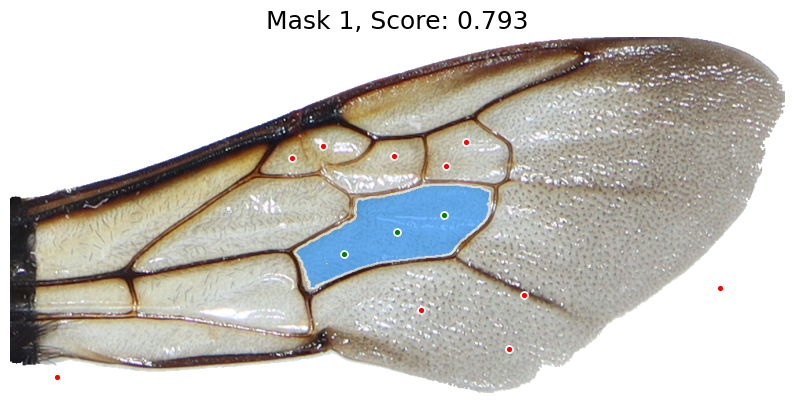

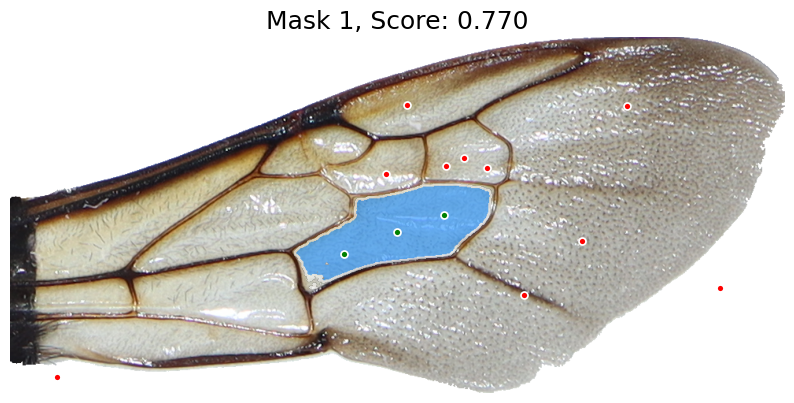

  0%|                                                                                                                                                                                      | 0/1193 [00:02<?, ?it/s]


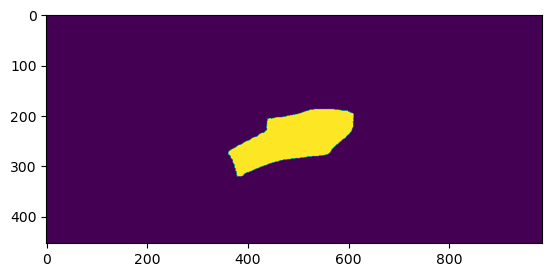

In [9]:
# Big cell segmentation
DEBUG = True
N_RANDOM_NEG = 10
RERUN = False # rerun with same points found previously, 

cells = ['FWL','MC','1sMC','2sMC','3sMC','2MdC']
cells_to_run = ['FWL','MC','1sMC','2sMC','3sMC','2MdC']
fps = sorted(glob('../2_live_bees/2_card_segs/*.png'))
#np.random.shuffle(fps)

for pos_cell in cells_to_run:
    for fp in tqdm(fps):
        if DEBUG:
            fp = '../2_live_bees/2_card_segs/2024_08_02_h33b28.png'
        wing_name = fp.split('/')[-1].split('.')[0]
        out_fp = f'../2_live_bees/7_{pos_cell}/' + wing_name + '.png'
        out_mask_fp = f'../2_live_bees/7_{pos_cell}_masks/' + wing_name + '.png'
        out_metadata_fp = f'../2_live_bees/7_{pos_cell}_metadata/' + wing_name + '.json'
        seg_and_orig_fp = f'../2_live_bees/7_{pos_cell}_seg_and_orig/' + wing_name + '.png'


        #if os.path.exists(out_fp):
        #    continue
            
        wing = cv2.imread(fp)
        wing = cv2.cvtColor(wing, cv2.COLOR_BGR2RGB)
        
        mask_fp = '../2_live_bees/2_final_masks/' + wing_name + '.png'
        mask = cv2.imread(mask_fp, cv2.IMREAD_GRAYSCALE)
        metadata_fp = '../2_live_bees/6_fine_registered_wings_metadata/' + wing_name + '.json'
    
        if not os.path.exists(metadata_fp):
            continue
        with open(metadata_fp, 'r') as f:
            metadata = json.load(f)
    
        sx, ex = metadata['crop_x']
        sy, ey = metadata['crop_y']
        wing = wing[sy:ey, sx:ex]
        #matched = match_histograms(wing, type_seg, channel_axis=-1)
        width = wing.shape[1]
        height = wing.shape[0]
        predictor.set_image(wing)
        
        pos = [metadata['SAM_points'][pos_cell]]
        neg_cells = deepcopy(cells)
        neg_cells.remove(pos_cell)
        neg = []
        for c in neg_cells:
            neg += [metadata['SAM_points'][c]]
        neg += [metadata['SAM_points']['other']]
            
        neg = [x for x in neg if len(x)]
        pos = np.concatenate(pos)  - np.array([sx, sy])
        neg = np.concatenate(neg) - np.array([sx, sy])
    
        neg = np.array([x for x in neg if x[0] > 0 and x[1] > 0 and x[0] < wing.shape[1] and x[1] < wing.shape[0]])
        pos = np.array([x for x in pos if x[0] > 0 and x[1] > 0 and x[0] < wing.shape[1] and x[1] < wing.shape[0]])
    
        if not len(pos) or not len(neg):
            print(f'No valid points for {wing_name}')
            wtf
            continue

        
        
        scores = []
        masks = []
        negs = []

        points_metadata_fp = f'../2_live_bees/7_{pos_cell}_metadata/' + wing_name + '.json'
        if RERUN and os.path.exists(points_metadata_fp):
            with open(points_metadata_fp, 'r') as f:
                points_metadata = json.load(f)
            negs += [np.array(points_metadata['negative_points'])]
            assert (pos - np.array(points_metadata['positive_points'])).sum() < 0.1
            
            input_labels = np.array([1]*len(pos) + [0]*len(negs[0]))
            input_points = np.concatenate([pos,negs[0]])
        
        
            mask, score, logits = predictor.predict(
                point_coords=input_points,
                point_labels=input_labels,
                multimask_output=False,
            ) 
            if DEBUG:
                show_masks(wing, mask, score, point_coords=input_points, input_labels=input_labels)
            scores += [score[0]]
            masks += [mask]
        else:
            for i in range(N_RANDOM_NEG):
                pos_indices = list(range(len(pos)))#np.random.randint(0, len(pos), size=5)
                neg_indices =  np.random.choice(range(len(neg)), size=min(10,len(neg)), replace=False)
                negs += [neg[neg_indices]]
                input_labels = np.array([1]*len(pos_indices) + [0]*len(neg_indices))
                input_points = np.concatenate([pos[pos_indices],neg[neg_indices]])
            
            
                mask, score, logits = predictor.predict(
                    point_coords=input_points,
                    point_labels=input_labels,
                    multimask_output=False,
                ) 
                if DEBUG:
                    show_masks(wing, mask, score, point_coords=input_points, input_labels=input_labels)
                scores += [score[0]]
                masks += [mask]
    
        sorted_ind = np.argsort(scores)[::-1]
        masks = np.array(masks)[sorted_ind]
        scores = np.array(scores)[sorted_ind]
        negs = np.array(negs)[sorted_ind]
        
        folders = [f'../2_live_bees/7_{pos_cell}/', f'../2_live_bees/7_{pos_cell}_masks/', f'../2_live_bees/7_{pos_cell}_metadata/',
                  f'../2_live_bees/7_{pos_cell}_seg_and_orig/']
        for folder in folders:
            if not os.path.exists(folder):
                os.makedirs(folder)
            
        mask = masks[0].squeeze()
    
        
        mask = (binary_closing(mask, iterations=3) > 0.5).astype('uint8')
        
        contours,hierarchy = cv2.findContours(mask.astype('uint8'), 1, 2)
        area_sorted_indices = np.argsort([cv2.contourArea(x) for x in contours])
        biggest_contour_index = area_sorted_indices[-1]
        biggest_contour = contours[biggest_contour_index]
        mask2 = np.zeros(mask.shape[:2]).astype('uint8')
        mask2 = cv2.drawContours(mask2, contours, biggest_contour_index, 255, -1)
        
        mask2 = np.expand_dims(mask2, 2)
        if DEBUG: 
            plt.figure()
            plt.imshow(mask2)
        
        #matched[np.wplt.imshow(mask2)here(mask2 > 0.5)] = (0.5*matched[np.where(mask2 > 0.5)] + \
        #                                         0.5*mask2[np.where(mask2 > 0.5)]).astype('uint8')
        wing2 = cv2.drawContours(deepcopy(wing), contours, biggest_contour_index, (150,0,0,100), -1)
        wing3 = cv2.drawContours(deepcopy(wing), contours, biggest_contour_index, (255,0,0), 3)
        for p in pos:
            wing3 = cv2.circle(wing3, (int(p[0]),int(p[1])), 5, (0,0,255), -1)
        for p in negs[0]:
            wing3 = cv2.circle(wing3, (int(p[0]),int(p[1])), 5, (255,0,0), -1)
    
        wing3 = cv2.addWeighted(wing3, 0.5, wing2, 0.5, 0)
        wing = cv2.cvtColor(wing, cv2.COLOR_RGB2BGR)
        wing3 = cv2.cvtColor(wing3, cv2.COLOR_RGB2BGR)


        
        metadata = {'score':float(scores[0]),
                    'positive_points': pos.tolist(),
                   'negative_points': negs[0].tolist(),
                   'area_in_pixels':cv2.contourArea(biggest_contour)}
        with open(out_metadata_fp, 'w') as f:
            json.dump(metadata, f)
        cv2.imwrite(out_mask_fp, mask2.squeeze().astype('uint8'))
        cv2.imwrite(out_fp, wing3)

        seg_and_orig = np.zeros((wing.shape[0], wing.shape[1]*2, 3))
        seg_and_orig[:,:wing.shape[1]] = wing3
        seg_and_orig[:,wing.shape[1]:] = wing
    
        cv2.imwrite(seg_and_orig_fp, seg_and_orig)
        if DEBUG:
            break
    #if DEBUG:
    #    break


In [10]:
name_to_class = {'FWL':1, 'MC':2, '1sMC':3, '2sMC':4,'3sMC':5,'2MdC':6}
cells = name_to_class.keys()
fps = glob('../2_live_bees/6_cropped_and_flipped/*')
fns = [x.split('/')[-1] for x in fps]


for fn in tqdm(fns):
    crop_fp = '../2_live_bees/6_cropped_and_flipped/' + fn
    crop = cv2.imread(crop_fp)

    mask = np.zeros(crop.shape[:2]).astype('uint8')
    if not os.path.exists(f'../2_live_bees/7_FWL_masks/' + fn):
        continue
    for cell in cells:
        cell_mask_fp = f'../2_live_bees/7_{cell}_masks/' + fn
        if not os.path.exists(cell_mask_fp):
            continue
        cell_mask = cv2.imread(cell_mask_fp, cv2.IMREAD_GRAYSCALE)
        if len(np.where(cell_mask > 0.5)):
            mask[np.where(cell_mask > 0.5)] = name_to_class[cell]

    meta_fp = '../2_live_bees/3_card_mask_matches_metadata/' + fn.replace('.png','.json')
    with open(meta_fp, 'r') as f:
        meta = json.load(f)

    if not meta['is_facing_up?']:
        mask = np.flipud(mask)

    
    cv2.imwrite('../2_live_bees/7_combined_masks/' + fn,mask)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1193/1193 [00:54<00:00, 21.82it/s]


In [6]:
cell_mask_fp

'../2_live_bees/7_FWL_masks/2024_06_06_h05bee05.png'

In [52]:
neg = []
for c in neg_cells:
    neg += [metadata['SAM_points'][c]]
neg += [metadata['SAM_points']['other']]

In [54]:
metadata

{'crop_x': [0, 740],
 'crop_y': [1552, 2173],
 'homography': [[-0.7917567821069265, 0.0779942076225999, -160.55176481463207],
  [-0.8273179819196808, -2.918401134722391, 3995.6942214913224],
  [-0.0004485988066448112, -0.0009433345347067874, 0.9999999999999999]],
 'width': 1595,
 'height': 4232,
 'SAM_points': {'MC': [[307.6066220489271, 1738.0526328013307],
   [390.4990581261661, 1675.8370516051614],
   [323.9160406695682, 1752.2732027943696]],
  '1sMC': [[169.99660452588307, 1889.9744078606623],
   [205.62654855456097, 1853.2978340405145]],
  '2sMC': [[248.90901652033332, 1882.1749572652873],
   [280.6440732496399, 1834.0927240708527],
   [268.46528315382466, 1866.4288506307378]],
  '3sMC': [[354.03760337813947, 1802.7694168869102],
   [361.31209037423463, 1774.3494968481405],
   [375.74233156736847, 1806.3264262844439],
   [333.6687994813754, 1824.2892942883188]],
  '2MdC': [[267.0337610428817, 1948.3968462447758],
   [211.0632921347533, 2003.5974615755053],
   [318.53409627570323, 

In [55]:
neg_cells

[]

In [28]:
negs

array([[[354.03760338, 250.76941689],
        [307.60662205, 186.0526328 ],
        [361.31209037, 222.34949685],
        [333.66879948, 272.28929429],
        [390.49905813, 123.83705161],
        [375.74233157, 254.32642628],
        [323.91604067, 200.27320279],
        [205.62654855, 301.29783404],
        [169.99660453, 337.97440786],
        [211.06329213, 451.59746158]]])